<a href="https://colab.research.google.com/github/subhadeepk/cse437-assignments/blob/main/lab12_SAC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Lab 12: Soft Actor Critic

Train a Soft Actor-Critic (SAC) agent on HalfCheetah-v4,
track its learning curve, and compare the result with your previous RL algorithm.

We will learn to use the **stable_baselines3** library


## To start
Run the following code that solves **the Pendulum problem**

In [ ]:
# Install dependencies
!pip install "stable-baselines3[extra]" "gymnasium[classic_control]"


DEPRECATION: omegaconf 2.0.6 has a non-standard dependency specifier PyYAML>=5.1.*. pip 24.1 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of omegaconf or contact the author to suggest that they release a version with a conforming dependency specifiers. Discussion can be found at https://github.com/pypa/pip/issues/12063

[notice] A new release of pip is available: 24.0 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


The following code trains a full SAC agent — with two critics, entropy tuning, and replay buffer — out of the box

In [ ]:
import gymnasium as gym
from stable_baselines3 import SAC

# Create environment
env = gym.make("Pendulum-v1")

# Create SAC model
model = SAC("MlpPolicy", env, verbose=1)

# Train the agent with N time steps
N = 4000
model.learn(total_timesteps=N)

Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
----------------------------------
| rollout/           |           |
|    ep_len_mean     | 200       |
|    ep_rew_mean     | -1.31e+03 |
| time/              |           |
|    episodes        | 4         |
|    fps             | 65        |
|    time_elapsed    | 12        |
|    total_timesteps | 800       |
| train/             |           |
|    actor_loss      | 19.1      |
|    critic_loss     | 0.194     |
|    ent_coef        | 0.813     |
|    ent_coef_loss   | -0.333    |
|    learning_rate   | 0.0003    |
|    n_updates       | 699       |
----------------------------------
----------------------------------
| rollout/           |           |
|    ep_len_mean     | 200       |
|    ep_rew_mean     | -1.39e+03 |
| time/              |           |
|    episodes        | 8         |
|    fps             | 61        |
|    time_elapsed    | 25        |
|    total_timesteps | 1600   

# Visualize the result

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import gymnasium as gym
from stable_baselines3 import SAC
from IPython.display import HTML

env = gym.make("Pendulum-v1", render_mode="rgb_array")


N_steps = 500

frames = []
obs, _ = env.reset()
for _ in range(N_steps):
    action, _ = model.predict(obs, deterministic=True)
    obs, reward, done, truncated, info = env.step(action)
    frame = env.render()
    frames.append(frame)
    if done or truncated:
        obs, _ = env.reset()

env.close()

# Create matplotlib animation
fig = plt.figure()
img = plt.imshow(frames[0])

def animate(i):
    img.set_data(frames[i])
    return [img]

ani = animation.FuncAnimation(fig, animate, frames=len(frames), interval=30)

plt.close()
HTML(ani.to_jshtml())


## Exercise 1: Soft Actor-Critic on HalfCheetah
**Goal:**
Adapt the existing Soft Actor-Critic (SAC) implementation from the Pendulum-v1 environment to train and evaluate a SAC agent on the more challenging HalfCheetah-v4 task.

### Instructions

1. Adapt your code: Modify your previous SAC implementation so that it runs on the HalfCheetah-v4 environment from MuJoCo.

2. Reward Logger:
Implement a custom RewardLogger callback to record episode rewards during training (you will have to search online about how to create a class for logger).
After training, use the logged data to plot the learning curve (episode reward vs. timesteps).

3. Experimentation:
    * Compare the performance of SAC on HalfCheetah-v4 with your previous algorithm.
    * Adjust the entropy temperature parameter (ent_coef or target_entropy) and observe how this affects: Exploration behavior, Convergence speed, and Final performance.

Answer the following questions
1. Did SAC reach a higher average reward or converge faster than your previous method?

2. How did changing the temperature for entropy affect the performance and stability of learning?

3. Describe any differences you observed in exploration or motion behavior of the agent.


### Deliverables

* Python notebook or script containing:
    * The adapted SAC training code
    * The RewardLogger implementation
    * Learning curve plots for SAC and your previous algorithm
    * Comparison of different entropy temperature settings

* The answer of the questions above

In [ ]:
!pip install gymnasium[mujoco]

DEPRECATION: omegaconf 2.0.6 has a non-standard dependency specifier PyYAML>=5.1.*. pip 24.1 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of omegaconf or contact the author to suggest that they release a version with a conforming dependency specifiers. Discussion can be found at https://github.com/pypa/pip/issues/12063

[notice] A new release of pip is available: 24.0 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [ ]:
from stable_baselines3.common.callbacks import BaseCallback

class RewardLogger(BaseCallback):
    """
    Custom callback for logging episode rewards and timesteps.
    Works with single-environment training.
    """

    def __init__(self, verbose=0):
        super().__init__(verbose)
        self.episode_rewards = []
        self.episode_lengths = []
        self.episode_timesteps = []

        # for tracking current episode
        self._current_rewards = 0.0
        self._current_length = 0

    def _on_step(self) -> bool:
        # self.locals["rewards"] and self.locals["dones"] come from the env.step()
        rewards = self.locals["rewards"]      # shape: (n_envs,)
        dones = self.locals["dones"]          # shape: (n_envs,)

        # assuming n_envs == 1
        r = float(rewards[0])
        done = bool(dones[0])

        self._current_rewards += r
        self._current_length += 1

        if done:
            # Record episode stats
            self.episode_rewards.append(self._current_rewards)
            self.episode_lengths.append(self._current_length)
            self.episode_timesteps.append(self.num_timesteps)  # global timestep

            # Reset counters for next episode
            self._current_rewards = 0.0
            self._current_length = 0

        return True   # returning False would stop training


In [ ]:
import gymnasium as gym
from stable_baselines3 import SAC

# Create environment
env = gym.make("HalfCheetah-v4")

# Create SAC model
model = SAC("MlpPolicy", env, verbose=0)

# Train the agent with N time steps
N = 50000
reward_logger = RewardLogger()
model.learn(total_timesteps=N, progress_bar = True, callback=reward_logger)

Output()

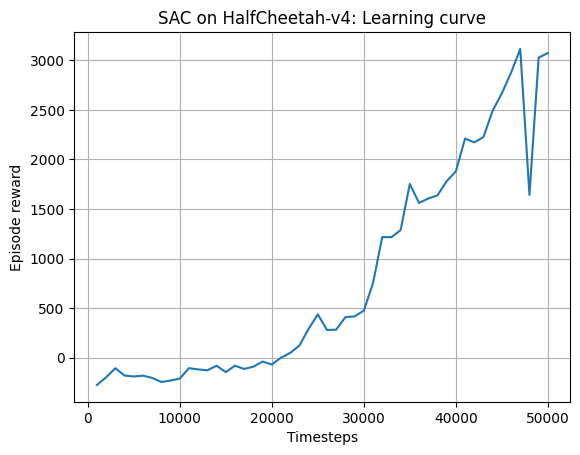

In [ ]:
import numpy as np

# Convert to numpy arrays for convenience
timesteps = np.array(reward_logger.episode_timesteps)
ep_rewards = np.array(reward_logger.episode_rewards)

plt.figure()
plt.plot(timesteps, ep_rewards)
plt.xlabel("Timesteps")
plt.ylabel("Episode reward")
plt.title("SAC on HalfCheetah-v4: Learning curve")
plt.grid(True)
plt.show()



In [ ]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import gymnasium as gym
from stable_baselines3 import SAC
from IPython.display import HTML

env = gym.make("HalfCheetah-v4", render_mode="rgb_array")


N_steps = 500

frames = []
obs, _ = env.reset()
for _ in range(N_steps):
    action, _ = model.predict(obs, deterministic=True)
    obs, reward, done, truncated, info = env.step(action)
    frame = env.render()
    frames.append(frame)
    if done or truncated:
        obs, _ = env.reset()

env.close()

# Create matplotlib animation
fig = plt.figure()
img = plt.imshow(frames[0])

def animate(i):
    img.set_data(frames[i])
    return [img]

ani = animation.FuncAnimation(fig, animate, frames=len(frames), interval=30)

plt.close()
HTML(ani.to_jshtml())


c:\Users\ksubh\anaconda3\envs\mquad_cuda\lib\site-packages\gymnasium\envs\registration.py:517: DeprecationWarning: WARN: The environment HalfCheetah-v4 is out of date. You should consider upgrading to version `v5`.
  logger.deprecation(
Animation size has reached 20975972 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [ ]:
model.save("C:\Users\ksubh\OneDrive\Documents\SwarmsLab_RL\Course\lab12_SAC.ipynb")

TypeError: save() missing 1 required positional argument: 'path'

1. Did SAC reach a higher average reward or converge faster than your previous method?
None of the previous methods(apart from deep q learning) would be able to solve this. SAC does better than them

2. How did changing the temperature for entropy affect the performance and stability of learning?
more temperature

3. Describe any differences you observed in exploration or motion behavior of the agent.